In [68]:
from graph_tool.all import *
import numpy as np
import time
import os

In [69]:
from GithubGraphML.parsing.loading import load_csv_graph, combine_graphs
data_dir = './data'
lang = 'Pascal'

# Simple Community Detection

In [70]:
start_time = time.time()
G, vp = load_csv_graph(f"{data_dir}/developers_social_network/{lang.upper()}_developers_social_network.csv", (1, 2), vprop_name='id')
G.ep['language'] = G.new_ep('string', val=lang)
G.set_directed(False)
end_time = time.time()
print('runtime:', end_time - start_time)
G

runtime: 0.07275128364562988


<Graph object, undirected, with 4241 vertices and 12008 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41440a0>

In [71]:
start_time = time.time()
state = minimize_blockmodel_dl(G)
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 1.1439321041107178


<BlockState object with 4241 blocks (34 nonempty), degree-corrected, for graph <Graph object, undirected, with 4241 vertices and 12008 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41440a0>, at 0x7f7bf4145d20>

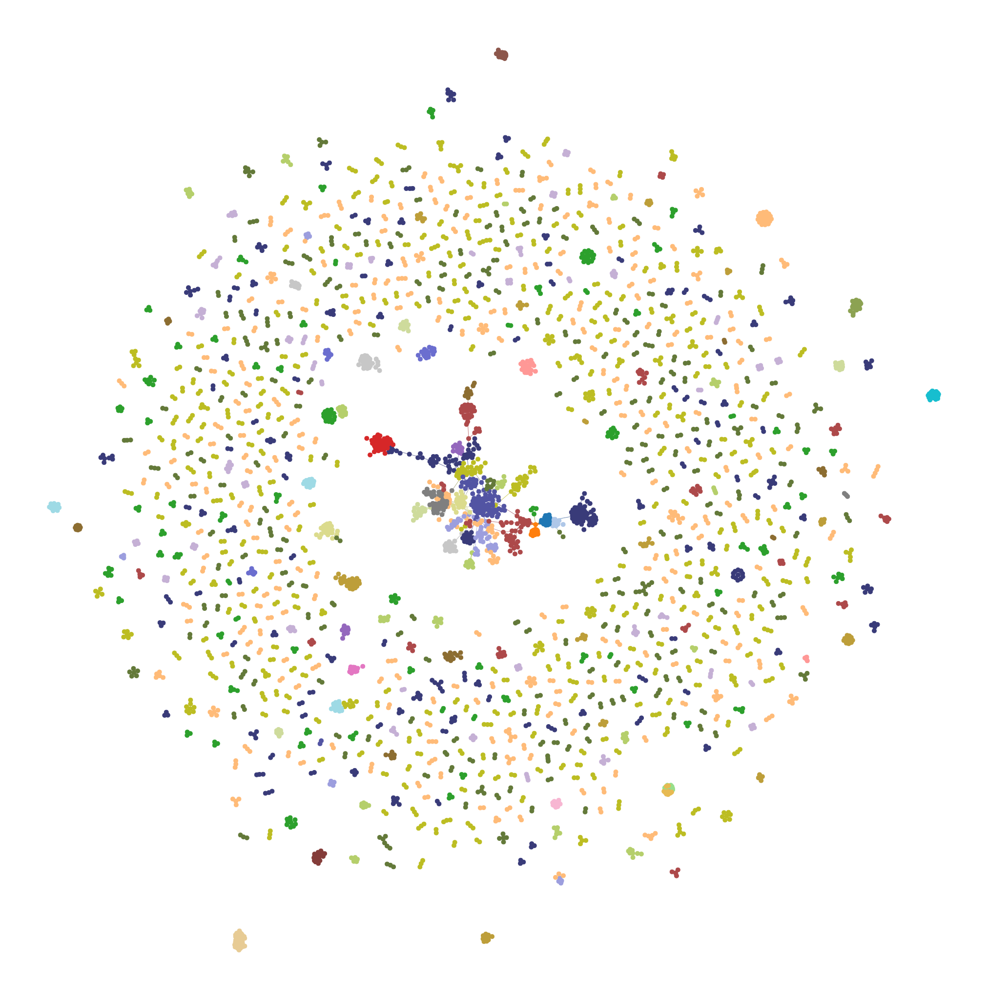

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41440a0, at 0x7f7b8c486590>

In [72]:
state.draw(fmt='png', output_size=(1024, 1024))

In [73]:
start_time = time.time()
commits = G.ep['number_commits'].t(lambda n: int(n), value_type='int')
state = minimize_blockmodel_dl(G, state_args=dict(
        recs=[commits],
        rec_types=["discrete-poisson"]    
))
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 3.763575553894043


<BlockState object with 4241 blocks (276 nonempty), degree-corrected, with 1 edge covariate, for graph <Graph object, undirected, with 4241 vertices and 12008 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41440a0>, at 0x7f7bf4146740>

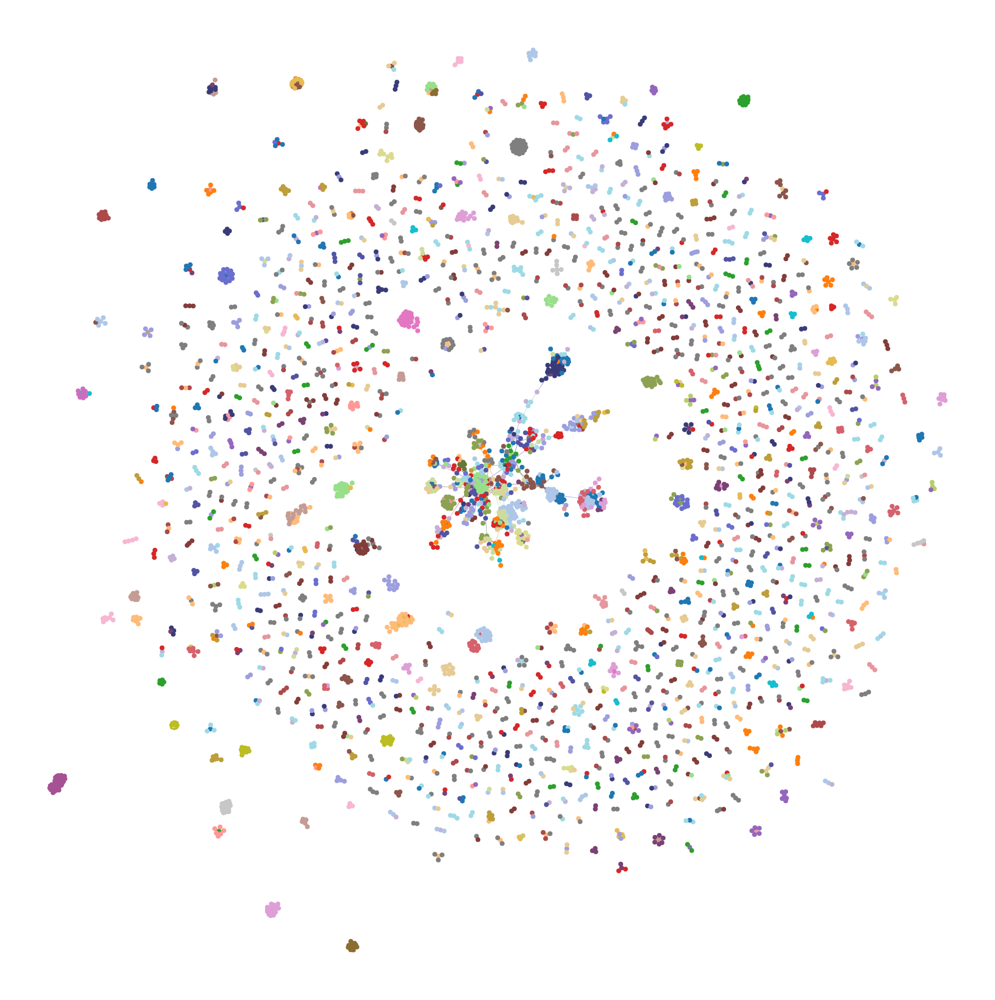

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41440a0, at 0x7f7c05557760>

In [74]:
state.draw(fmt='png', output_size=(1024, 1024))

In [75]:
start_time = time.time()
state = minimize_nested_blockmodel_dl(G)
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 1.8511626720428467


<NestedBlockState object, with base <BlockState object with 4241 blocks (42 nonempty), degree-corrected, for graph <Graph object, undirected, with 4241 vertices and 12008 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41440a0>, at 0x7f7b8c4cc430>, and 14 levels of sizes [(4241, 42), (42, 13), (13, 5), (5, 2), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1)] at 0x7f7bf4145210>

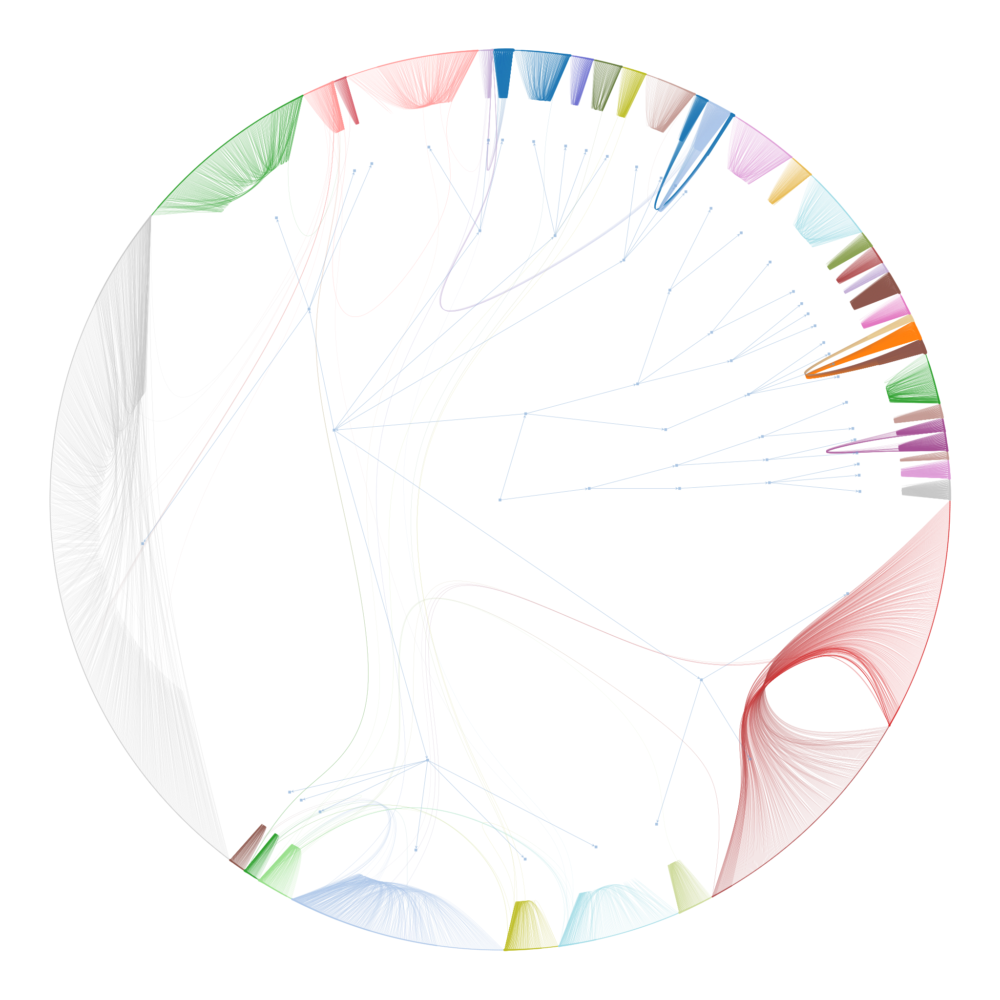

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41440a0, at 0x7f7bf41452a0>,
 <GraphView object, directed, with 4304 vertices and 4303 edges, edges filtered by <EdgePropertyMap object with value type 'bool', for Graph 0x7f7bf4146aa0, at 0x7f7bf4369cf0>, vertices filtered by <VertexPropertyMap object with value type 'bool', for Graph 0x7f7bf4146aa0, at 0x7f7bf436a320>, at 0x7f7bf4146aa0>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf4146aa0, at 0x7f7bf436a5f0>)

In [76]:
state.draw(fmt='png', output_size=(1024, 1024))

In [77]:
start_time = time.time()
commits = G.ep['number_commits'].t(lambda n: int(n), value_type='int')
state = minimize_nested_blockmodel_dl(G, state_args=dict(
        recs=[commits],
        rec_types=["discrete-poisson"]    
))
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 24.443821907043457


<NestedBlockState object, with base <BlockState object with 4241 blocks (302 nonempty), degree-corrected, with 1 edge covariate, for graph <Graph object, undirected, with 4241 vertices and 12008 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41440a0>, at 0x7f7bf436bdc0>, and 14 levels of sizes [(4241, 302), (302, 60), (60, 20), (20, 8), (8, 4), (4, 2), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1)] at 0x7f7b8c4c5f00>

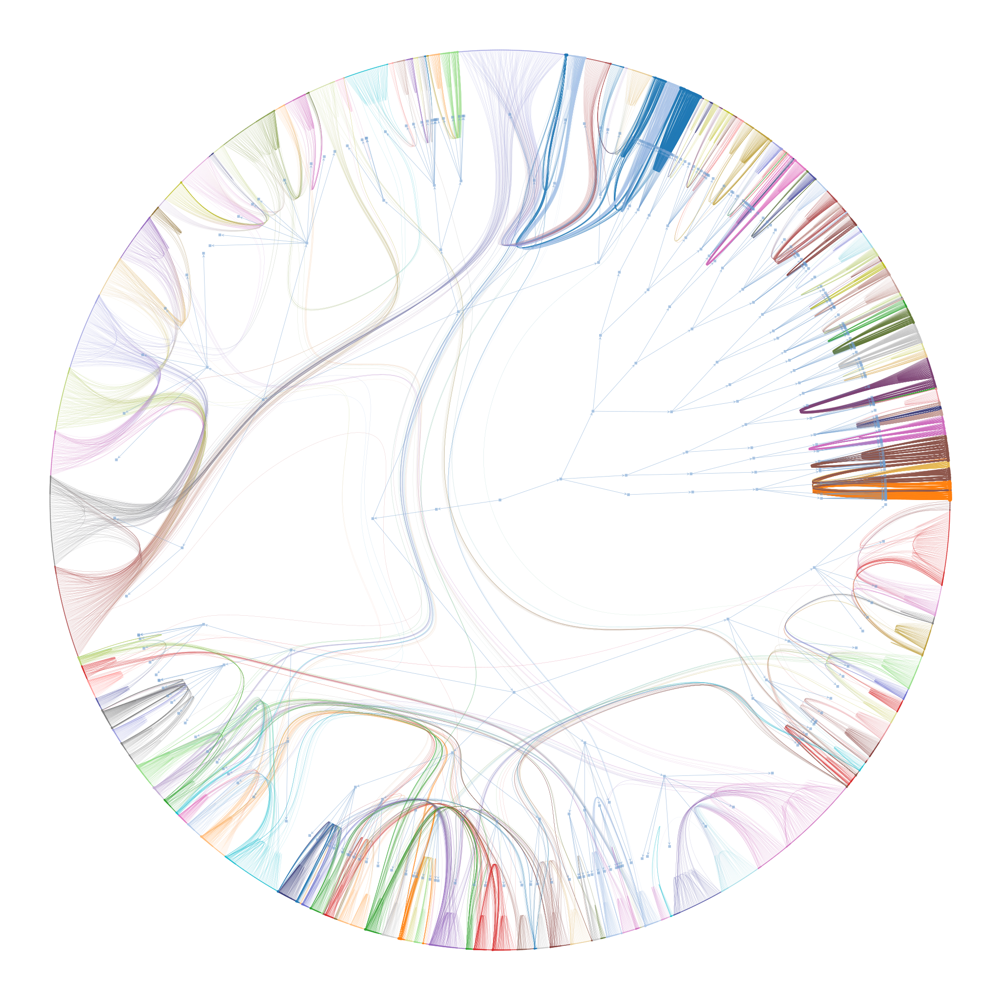

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41440a0, at 0x7f7c055559c0>,
 <GraphView object, directed, with 4638 vertices and 4637 edges, edges filtered by <EdgePropertyMap object with value type 'bool', for Graph 0x7f7bf42c7a30, at 0x7f7b8c43df00>, vertices filtered by <VertexPropertyMap object with value type 'bool', for Graph 0x7f7bf42c7a30, at 0x7f7b8c4ccac0>, at 0x7f7bf42c7a30>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf42c7a30, at 0x7f7b8c43d930>)

In [78]:
state.draw(fmt='png', output_size=(1024, 1024))

# Multiple Langauge Community Detection

In [79]:
start_time = time.time()
G1, _ = load_csv_graph(f"{data_dir}/developers_social_network/PASCAL_developers_social_network.csv", (1, 2), vprop_name='id')
G1.ep['language'] = G1.new_ep('string', val='Pascal')
G2, _ = load_csv_graph(f"{data_dir}/developers_social_network/ASSEMBLY_developers_social_network.csv", (1, 2), vprop_name='id')
G2.ep['language'] = G2.new_ep('string', val='Assembly')
G3, _ = load_csv_graph(f"{data_dir}/developers_social_network/VISUALBASIC_developers_social_network.csv", (1, 2), vprop_name='id')
G3.ep['language'] = G3.new_ep('string', val='VisualBasic')
G, _ = combine_graphs([G1, G2, G3], vprop_name='id')
G.set_directed(False)
end_time = time.time()
print('runtime:', end_time - start_time)
G

runtime: 2.2778944969177246


<Graph object, undirected, with 20922 vertices and 46379 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41a0ac0>

In [80]:
start_time = time.time()
state = minimize_blockmodel_dl(G)
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 8.215462684631348


<BlockState object with 20922 blocks (77 nonempty), degree-corrected, for graph <Graph object, undirected, with 20922 vertices and 46379 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41a0ac0>, at 0x7f7b8c43c940>

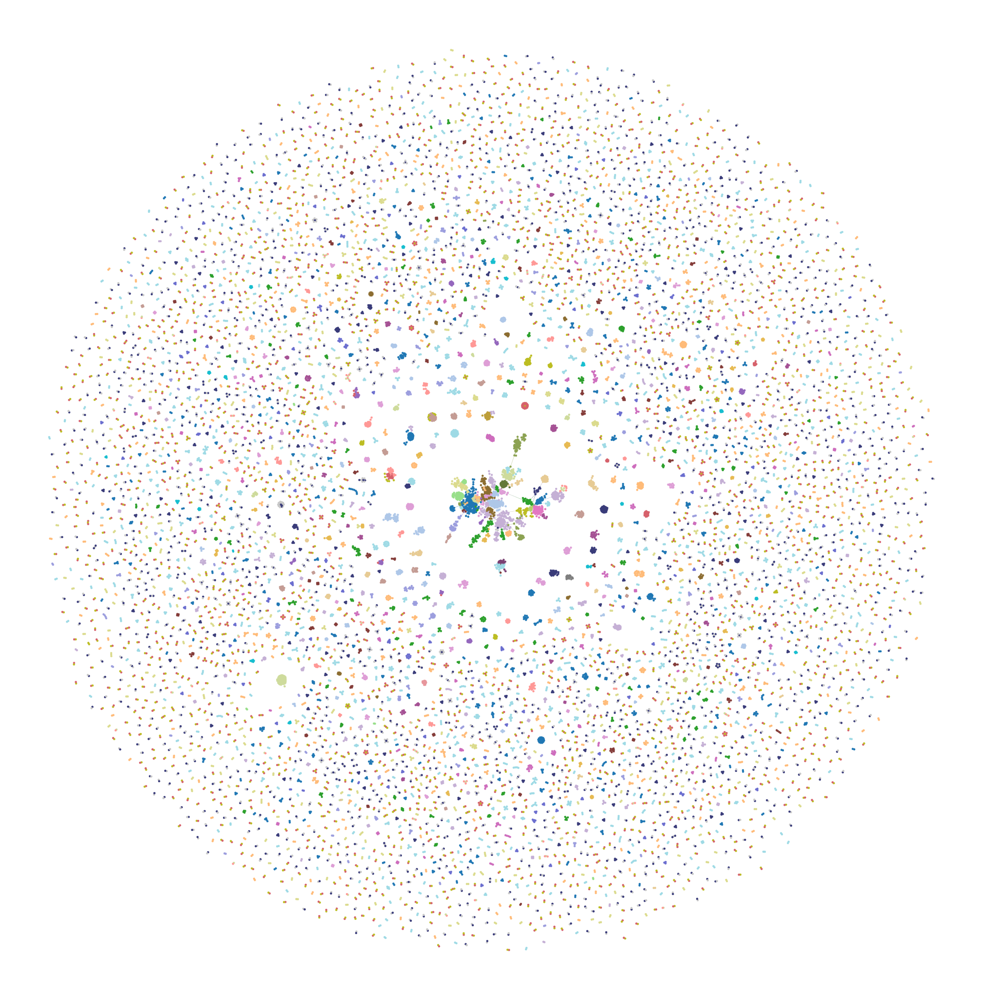

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41a0ac0, at 0x7f7b8c4cdb70>

In [81]:
state.draw(fmt='png', output_size=(1024, 1024))

In [82]:
start_time = time.time()
commits = G.ep['number_commits'].t(lambda n: int(n), value_type='int')
state = minimize_blockmodel_dl(G, state_args=dict(
        recs=[commits],
        rec_types=["discrete-poisson"]    
))
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 22.21231508255005


<BlockState object with 20922 blocks (506 nonempty), degree-corrected, with 1 edge covariate, for graph <Graph object, undirected, with 20922 vertices and 46379 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41a0ac0>, at 0x7f7bf436a4d0>

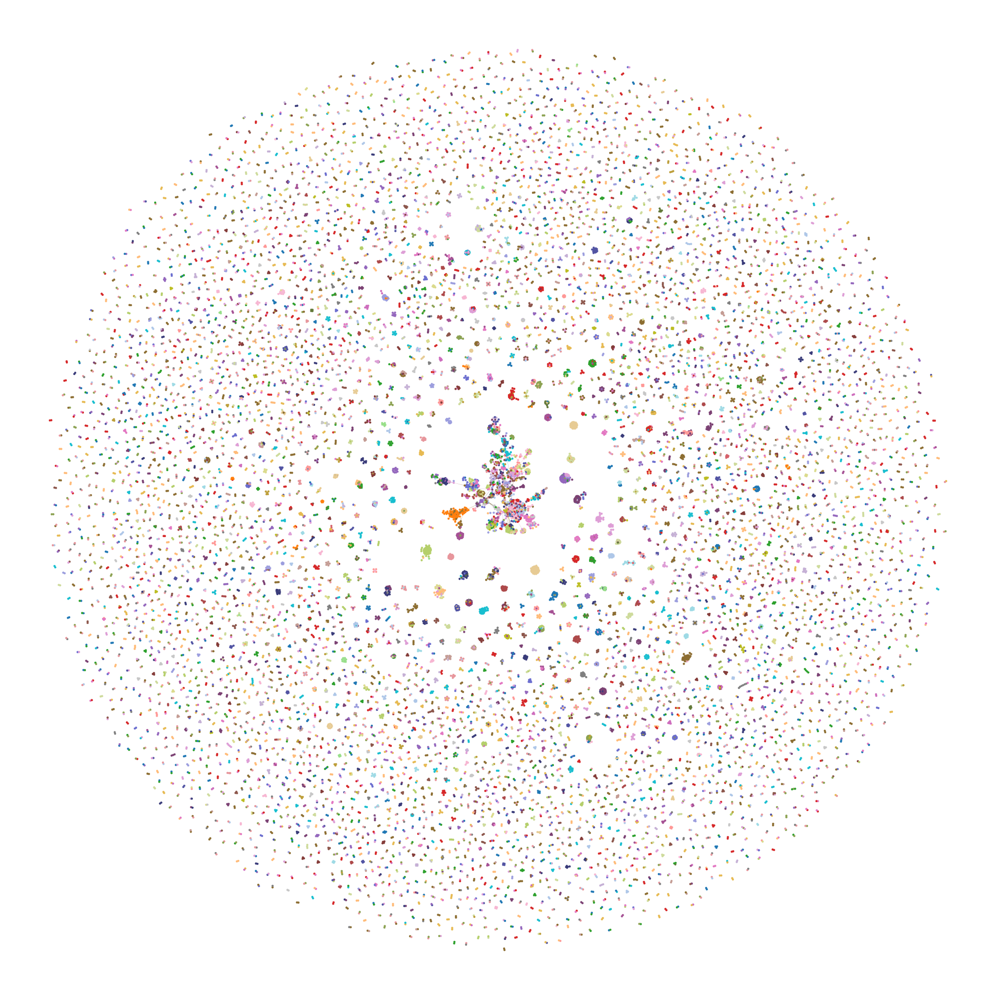

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41a0ac0, at 0x7f7bf4145e10>

In [83]:
state.draw(fmt='png', output_size=(1024, 1024))

In [84]:
start_time = time.time()
state = minimize_nested_blockmodel_dl(G)
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 14.15555191040039


<NestedBlockState object, with base <BlockState object with 20922 blocks (75 nonempty), degree-corrected, for graph <Graph object, undirected, with 20922 vertices and 46379 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41a0ac0>, at 0x7f7bf436bf40>, and 16 levels of sizes [(20922, 75), (75, 30), (30, 10), (10, 4), (4, 2), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1)] at 0x7f7bf4369e10>

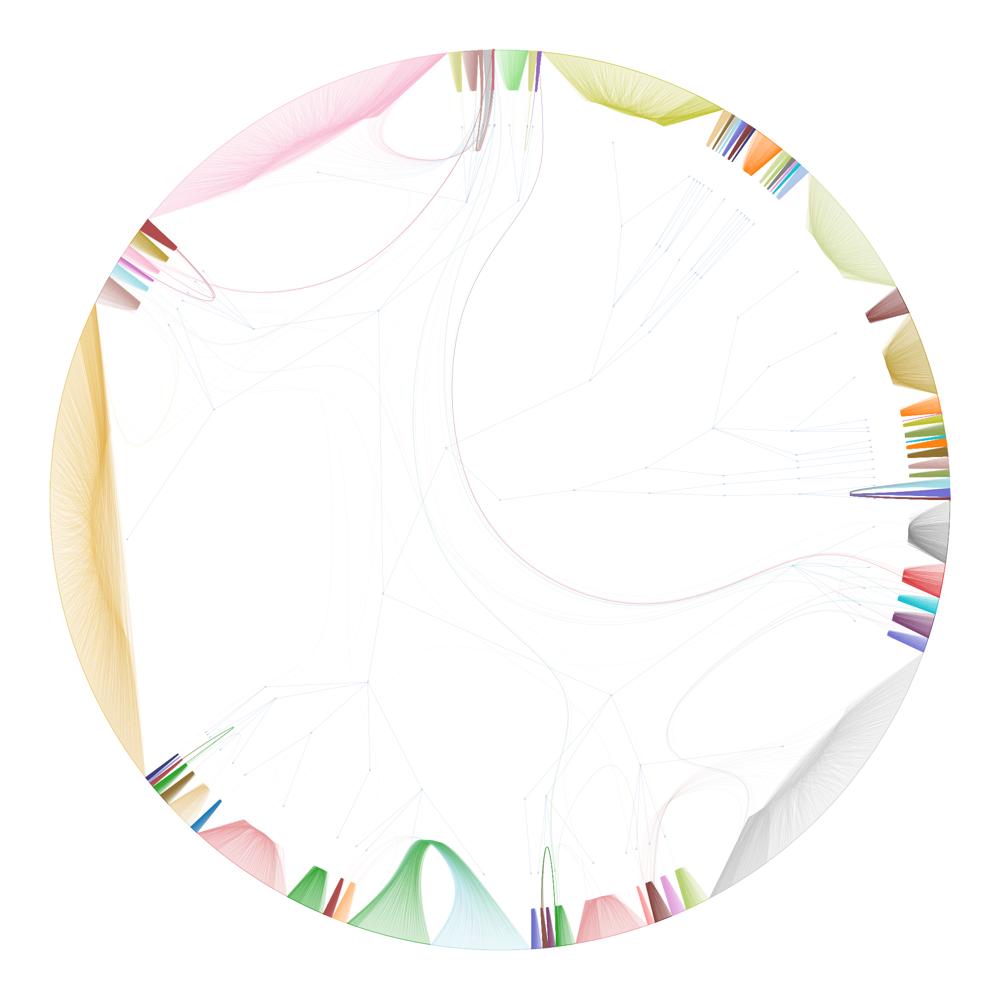

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41a0ac0, at 0x7f7bf4162fe0>,
 <GraphView object, directed, with 21044 vertices and 21043 edges, edges filtered by <EdgePropertyMap object with value type 'bool', for Graph 0x7f7bf4161510, at 0x7f7bf4163190>, vertices filtered by <VertexPropertyMap object with value type 'bool', for Graph 0x7f7bf4161510, at 0x7f7bf4161750>, at 0x7f7bf4161510>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf4161510, at 0x7f7bf4162980>)

In [85]:
state.draw(fmt='png', output_size=(1024, 1024))

In [88]:
start_time = time.time()
commits = G.ep['number_commits'].t(lambda n: int(n), value_type='int')
state = minimize_nested_blockmodel_dl(G, state_args=dict(
        recs=[commits],
        rec_types=["discrete-poisson"]    
))
end_time = time.time()
print('runtime:', end_time - start_time)
state

runtime: 148.0007517337799


<NestedBlockState object, with base <BlockState object with 20922 blocks (391 nonempty), degree-corrected, with 1 edge covariate, for graph <Graph object, undirected, with 20922 vertices and 46379 edges, 1 internal vertex property, 6 internal edge properties, at 0x7f7bf41a0ac0>, at 0x7f7bf41618d0>, and 16 levels of sizes [(20922, 391), (391, 109), (109, 31), (31, 10), (10, 5), (5, 2), (2, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1)] at 0x7f7bf4162650>

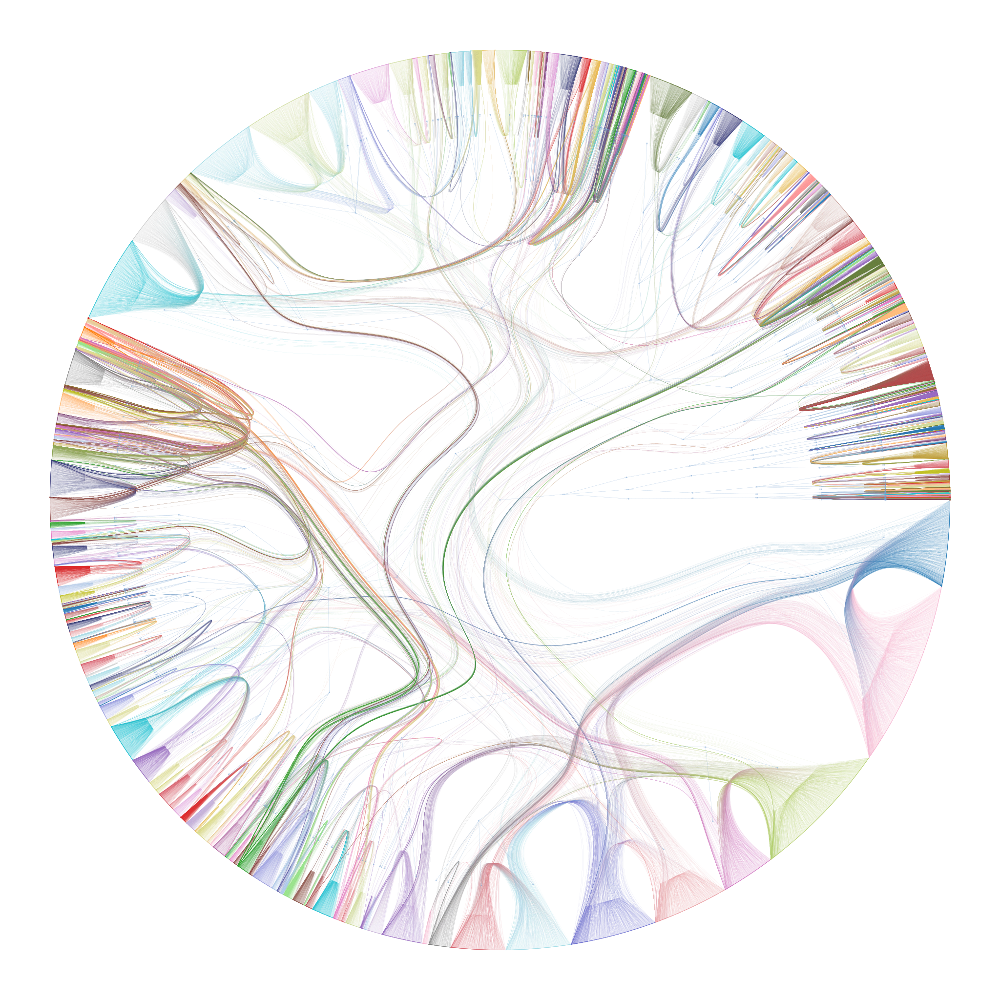

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf41a0ac0, at 0x7f7bf41634f0>,
 <GraphView object, directed, with 21471 vertices and 21470 edges, edges filtered by <EdgePropertyMap object with value type 'bool', for Graph 0x7f7bf4162cb0, at 0x7f7b8be290f0>, vertices filtered by <VertexPropertyMap object with value type 'bool', for Graph 0x7f7bf4162cb0, at 0x7f7bf41cce80>, at 0x7f7bf4162cb0>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f7bf4162cb0, at 0x7f7b8be280d0>)

In [89]:
state.draw(fmt='png', output_size=(1024, 1024))